# Downloading and Loading Dataset into Google Colab


In [1]:
!chmod 600 /root/.kaggle/kaggle.json


chmod: cannot access '/root/.kaggle/kaggle.json': No such file or directory


In [2]:
!pip install kaggle

In [3]:
from google.colab import files
uploaded = files.upload()

Saving kaggle.json to kaggle.json


In [4]:
import os

os.makedirs('/root/.kaggle', exist_ok=True)
os.rename('kaggle.json', '/root/.kaggle/kaggle.json')

In [5]:
!kaggle datasets download -d "wadhasnalhamdan/date-fruit-image-dataset-in-controlled-environment"


Dataset URL: https://www.kaggle.com/datasets/wadhasnalhamdan/date-fruit-image-dataset-in-controlled-environment
License(s): Attribution 4.0 International (CC BY 4.0)
100% 3.10G/3.11G [00:50<00:00, 60.1MB/s]
100% 3.11G/3.11G [00:51<00:00, 65.5MB/s]


In [6]:
import zipfile

with zipfile.ZipFile('date-fruit-image-dataset-in-controlled-environment.zip', 'r') as zip_ref:
    zip_ref.extractall('path/to/extract')


In [ ]:
import shutil

folder_path = '/content/path/to/extract/Ajwa'

shutil.rmtree(folder_path)


# Image Preprocessing and Analysis

**Image Property Analysis and Dataset Overview**


Description:

This Python code analyzes the properties of images within a specified folder and provides an overview of the dataset. It calculates and displays various properties such as image dimensions, aspect ratio, number of channels, pixel value range, color scale, and file size.

In [9]:
import os
from PIL import Image
import numpy as np

def check_image_properties(image_folder, max_images_per_class=10):
    class_counts = {}  # Dictionary to store the count of images for each class
    images_per_class = {}  # Dictionary to store images organized by class
    for dirname, _, filenames in os.walk(image_folder):
        print(dirname)
        for filename in filenames:
            image_path = os.path.join(dirname, filename)
            image = Image.open(image_path)
            width, height = image.size
            aspect_ratio = width / height

            image_array = np.array(image)

            # to get the number of channels in the image
            num_channels = image_array.shape[2] if len(image_array.shape) == 3 else 1

            # to get the minimum and maximum pixel values
            min_pixel_value = np.min(image_array)
            max_pixel_value = np.max(image_array)

            # to calculate the scale of pixel values
            pixel_scale = max_pixel_value - min_pixel_value

            class_name = filename.split()[0]  # to extract the class name from the filename

            # Update the count for the current class
            class_counts[class_name] = class_counts.get(class_name, 0) + 1

            # to collect images for each class up to the specified limit
            if class_name not in images_per_class:
                images_per_class[class_name] = []
            if len(images_per_class[class_name]) < max_images_per_class:
                images_per_class[class_name].append(image_path)

            print(f"Image: {filename}")
            print(f"Dimensions: {width}x{height}")
            print(f"Aspect Ratio: {aspect_ratio:.2f}")
            print(f"Number of Channels: {num_channels}")

            # to check if the pixel values are already normalized or in the range [0, 255]
            if min_pixel_value >= 0 and max_pixel_value <= 1:
                print("Pixel values are already normalized (range [0, 1])")
            elif min_pixel_value >= 0 and max_pixel_value <= 255:
                print("Pixel values are in the range [0, 255]")
            else:
                print("Pixel values are outside the expected range")

            print(f"Pixel Value Scale: {pixel_scale}")

            if num_channels == 1:
                print("Color Scale: Grayscale")
            elif num_channels == 3:
                print("Color Scale: RGB")
            else:
                print(f"Color Scale: Unknown ({num_channels} channels)")

            print(f"Size (in bytes): {os.path.getsize(image_path)} bytes")

            print()

    print("Number of images for each class:")
    for class_name, count in class_counts.items():
        print(f"{class_name}: {count}")

    return images_per_class

# Specify the folder containing your images and the maximum number of images per class
image_folder = 'path/to/extract'
max_images_per_class = 10
images_dict = check_image_properties(image_folder, max_images_per_class)
print('end')


Streaming output truncated to the last 5000 lines.

Image: Nabtat Ali Date (156).JPG
Dimensions: 3456x2304
Aspect Ratio: 1.50
Number of Channels: 3
Pixel values are in the range [0, 255]
Pixel Value Scale: 255
Color Scale: RGB
Size (in bytes): 2067128 bytes

Image: Nabtat Ali Date (167).JPG
Dimensions: 3456x2304
Aspect Ratio: 1.50
Number of Channels: 3
Pixel values are in the range [0, 255]
Pixel Value Scale: 255
Color Scale: RGB
Size (in bytes): 1826346 bytes

Image: Nabtat Ali Date (76).JPG
Dimensions: 3456x2304
Aspect Ratio: 1.50
Number of Channels: 3
Pixel values are in the range [0, 255]
Pixel Value Scale: 254
Color Scale: RGB
Size (in bytes): 1791633 bytes

Image: Nabtat Ali Date (7).JPG
Dimensions: 3456x2304
Aspect Ratio: 1.50
Number of Channels: 3
Pixel values are in the range [0, 255]
Pixel Value Scale: 252
Color Scale: RGB
Size (in bytes): 1924936 bytes

Image: Nabtat Ali Date (63).JPG
Dimensions: 3456x2304
Aspect Ratio: 1.50
Number of Channels: 3
Pixel values are in the rang

**Date Fruit Image Segmentation Pipeline**

Description:

This code implements a pipeline for segmenting date fruit images from its  background. It first crops the images to the region of interest (ROI) and resizes them to a target size. Next, it converts the resized images to the HSV color space and performs color-based segmentation to isolate the date fruits. Morphological closing is applied to refine the segmentation mask. Finally, the original, segmented, and processed images are visualized for evaluation.

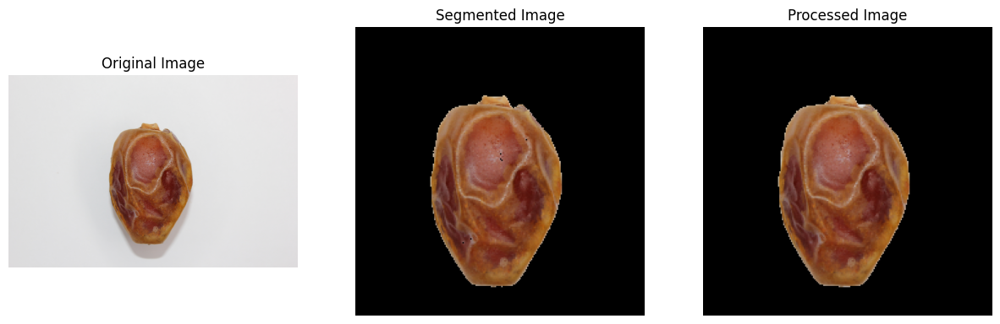

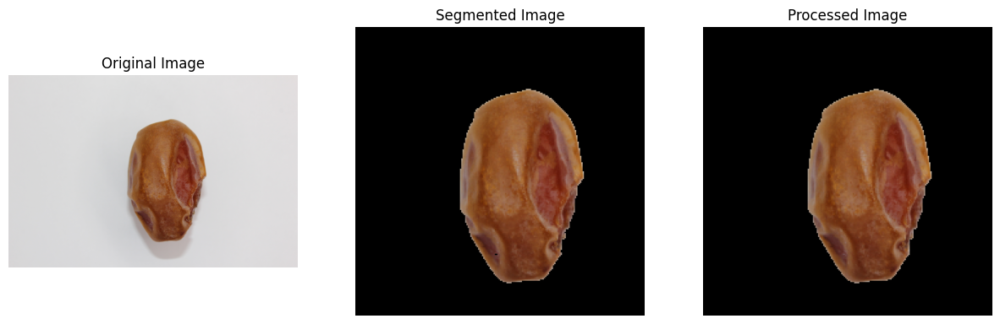

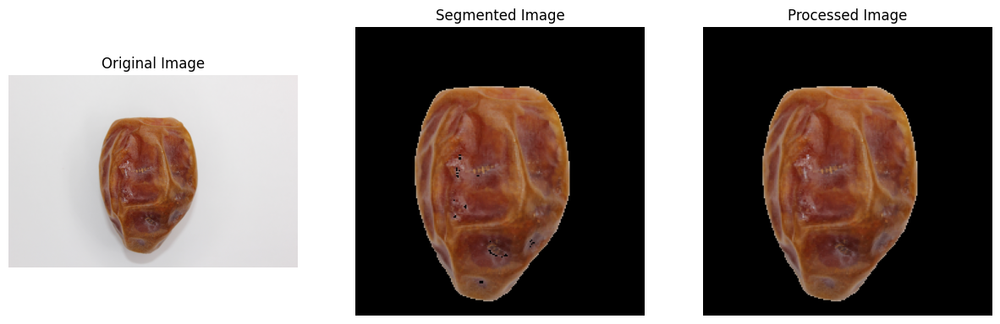

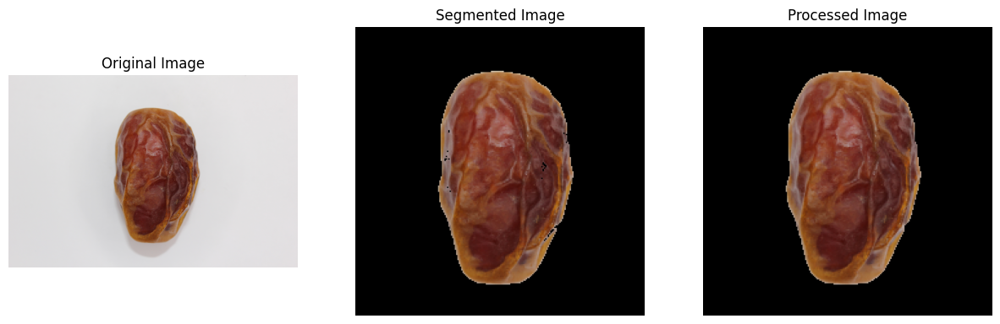

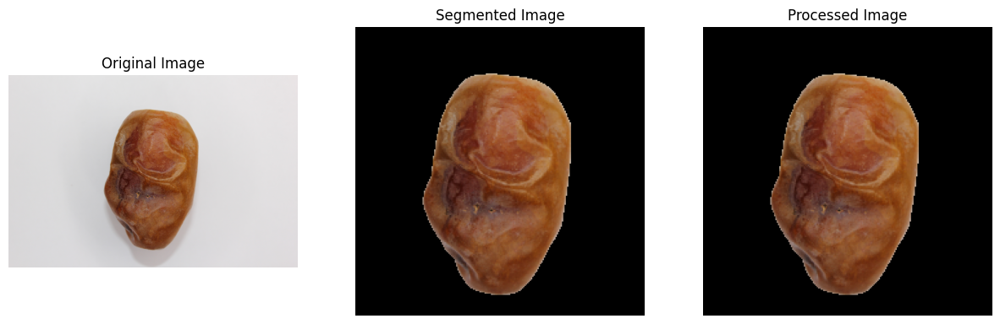

...

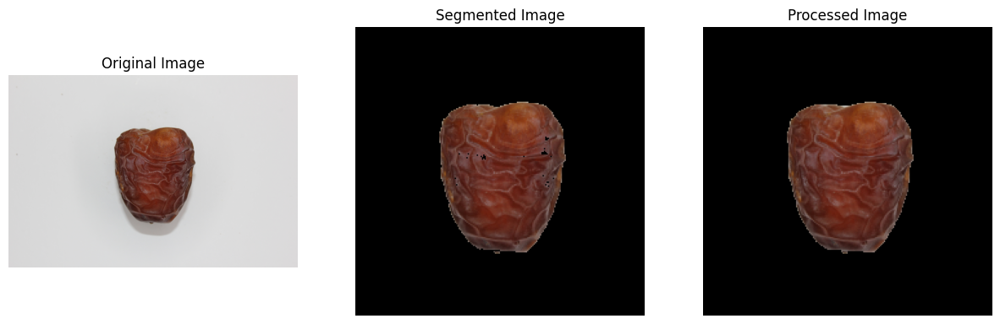

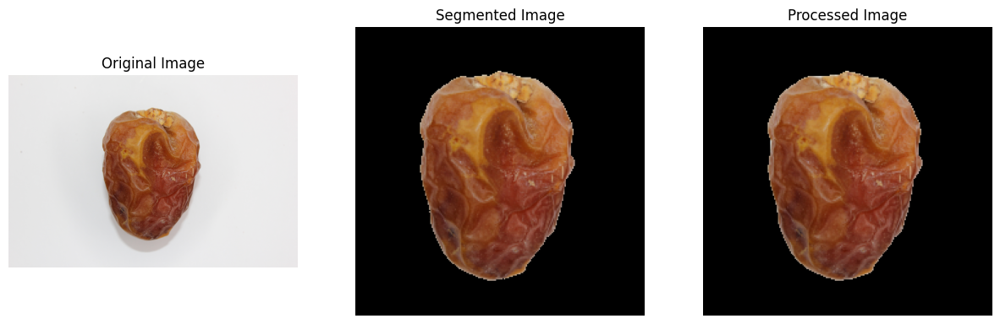

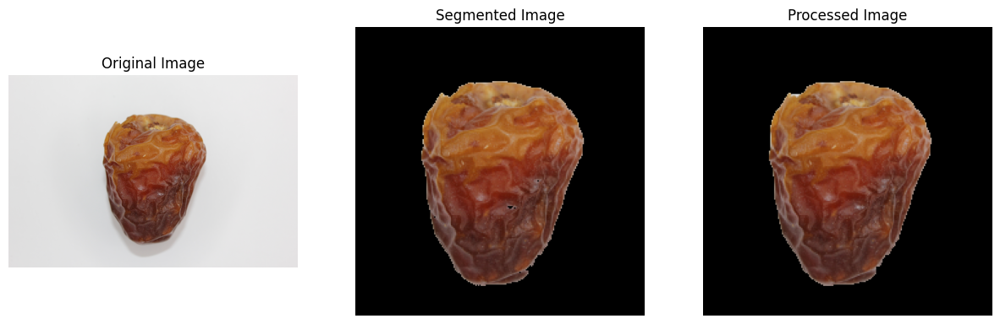

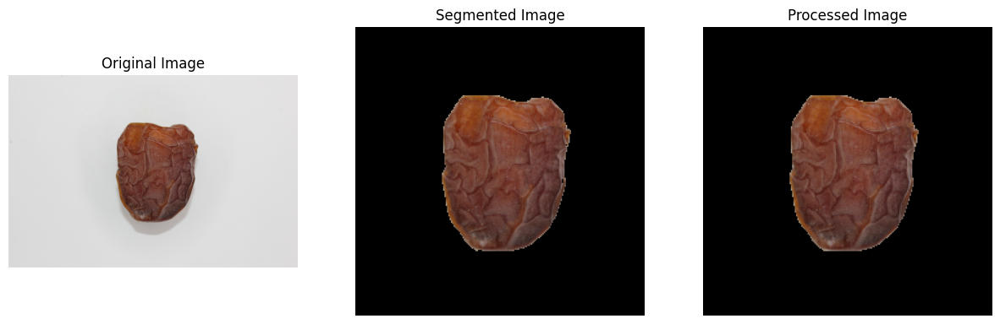

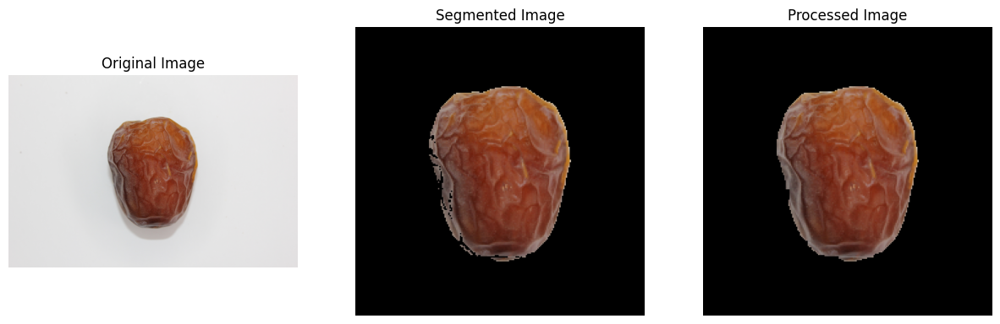

In [10]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os


for type_name, image_paths in images_dict.items():

        for image_path in image_paths:
            image = cv2.imread(image_path)

            # Crop the image to the region of interest (ROI)
            roi_width = 2200
            roi_height = 2200
            roi_x = (image.shape[1] - roi_width) // 2
            roi_y = (image.shape[0] - roi_height) // 2

            # Crop the image to the ROI
            cropped_image = image[roi_y:roi_y+roi_height, roi_x:roi_x+roi_width]
            cropped_width = cropped_image.shape[1]
            cropped_height = cropped_image.shape[0]
            cropped_aspect_ratio = cropped_width / cropped_height

            # Calculate the target height based on the aspect ratio of the cropped image
            target_width = 224
            target_height = int(target_width / cropped_aspect_ratio)

            # Resize the cropped image to the target dimensions
            resized_image = cv2.resize(cropped_image, (target_width, target_height), interpolation=cv2.INTER_AREA)

            # Convert the resized image to HSV color space
            hsv_image = cv2.cvtColor(resized_image, cv2.COLOR_BGR2HSV)

            # Define the lower and upper bounds for color segmentation
            lower_color = np.array([0, 40, 0])
            upper_color = np.array([70, 255, 255])

           # Create a mask using the defined color range
            mask = cv2.inRange(hsv_image, lower_color, upper_color)
            segmented_image = cv2.bitwise_and(resized_image, resized_image, mask=mask)

            # Perform morphological closing to fill gaps and smooth the mask

            kernel = np.ones((7, 7), np.uint8)
            processed_mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=1)

            # Apply the processed mask to the original image
            processed_image = cv2.bitwise_and(resized_image, resized_image, mask=processed_mask)

            # Convert the original image, segmented image, and processed image to RGB for visualization
            original_image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            segmented_image_rgb = cv2.cvtColor(segmented_image, cv2.COLOR_BGR2RGB)
            adjusted_image_rgb = cv2.cvtColor(processed_image, cv2.COLOR_BGR2RGB)
            plt.figure(figsize=(15, 5))

            plt.subplot(1, 3, 1)
            plt.imshow(original_image_rgb)
            plt.title('Original Image')
            plt.axis('off')

            plt.subplot(1, 3, 2)
            plt.imshow(segmented_image_rgb)
            plt.title('Segmented Image')
            plt.axis('off')

            plt.subplot(1, 3, 3)
            plt.imshow(adjusted_image_rgb)
            plt.title('Processed Image')
            plt.axis('off')


            plt.show()


In [ ]:
# !zip -r segmented_image.zip /content/segmented_images

  adding: content/segmented_images/ (stored 0%)
  adding: content/segmented_images/Sugaey/ (stored 0%)
  adding: content/segmented_images/Sugaey/Sugaey Date (112).JPG (deflated 15%)
  adding: content/segmented_images/Sugaey/Sugaey Date (152).JPG (deflated 13%)
  adding: content/segmented_images/Sugaey/Sugaey Date (23).JPG (deflated 15%)
  adding: content/segmented_images/Sugaey/Sugaey Date (43).JPG (deflated 17%)
  adding: content/segmented_images/Sugaey/Sugaey Date (160).JPG (deflated 15%)
  adding: content/segmented_images/Sugaey/Sugaey Date (44).JPG (deflated 13%)
  adding: content/segmented_images/Sugaey/Sugaey Date (167).JPG (deflated 13%)
  adding: content/segmented_images/Sugaey/Sugaey Date (82).JPG (deflated 16%)
  adding: content/segmented_images/Sugaey/Sugaey Date (73).JPG (deflated 16%)
  adding: content/segmented_images/Sugaey/Sugaey Date (166).JPG (deflated 15%)
  adding: content/segmented_images/Galaxy/ (stored 0%)
  adding: content/segmented_images/Galaxy/Galaxy Date (10

**NOTE:The code for normalization is in the other file **


# Exploratory Image Processing Codes

Descitpotin:

These scripts document approaches and experiments conducted during the development process, providing insights into the evolution of the final solution.

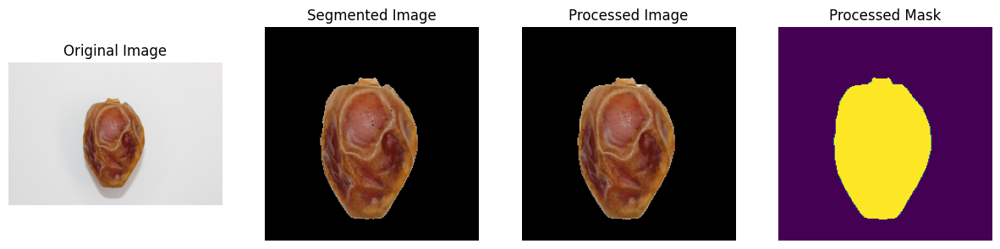

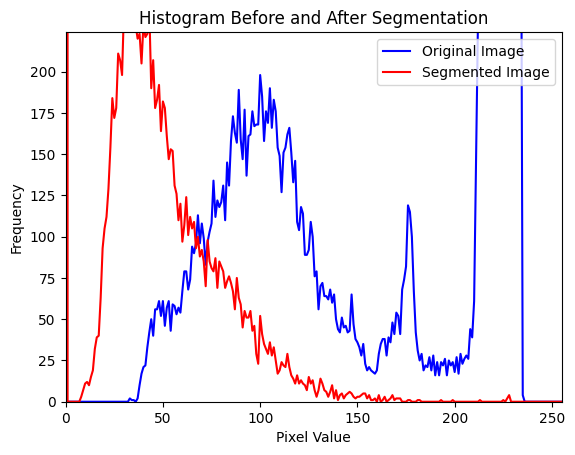

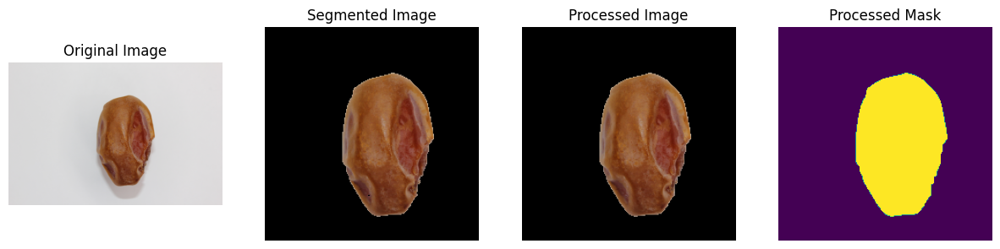

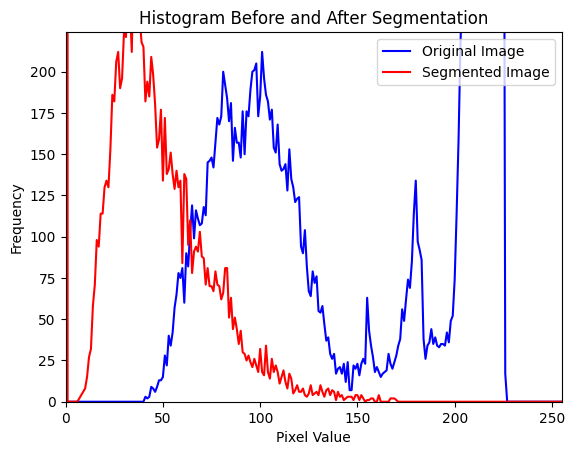

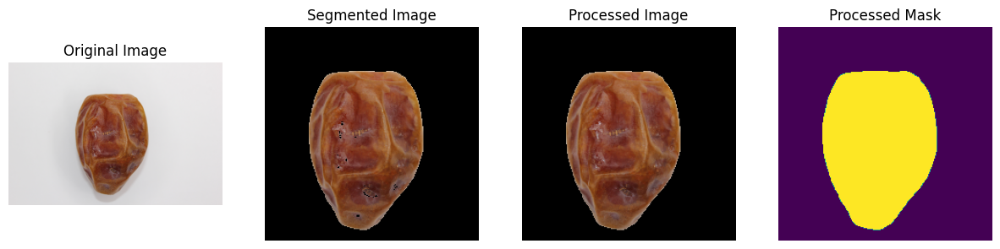

...

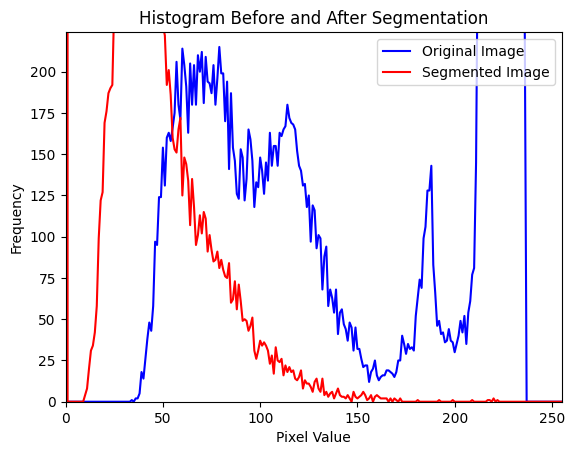

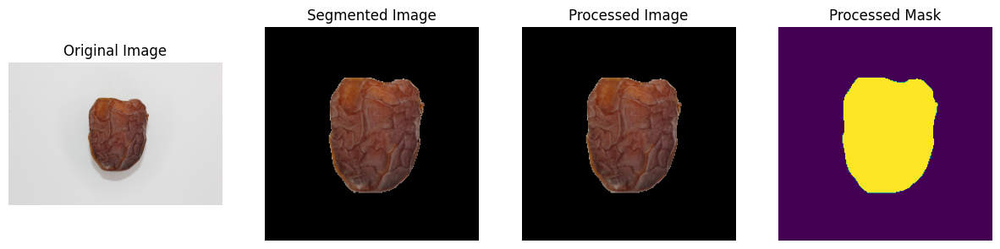

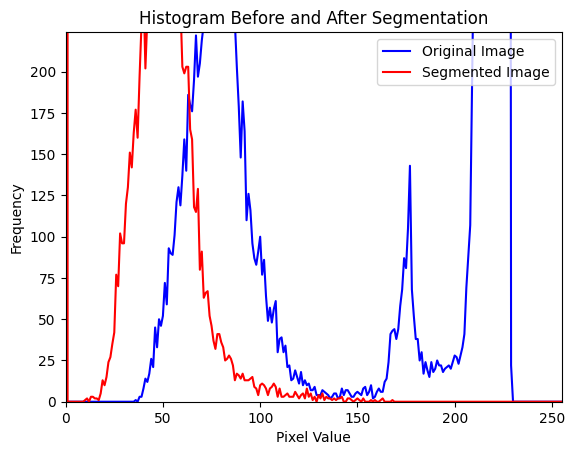

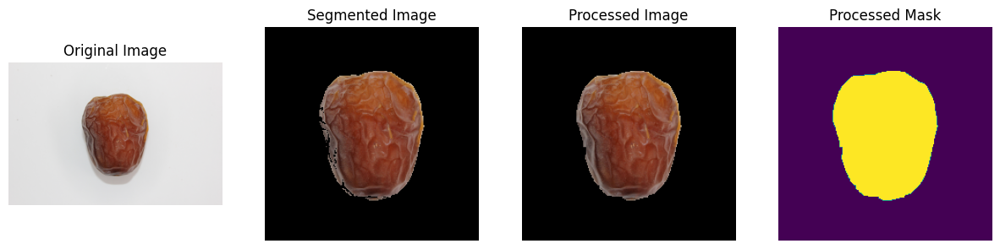

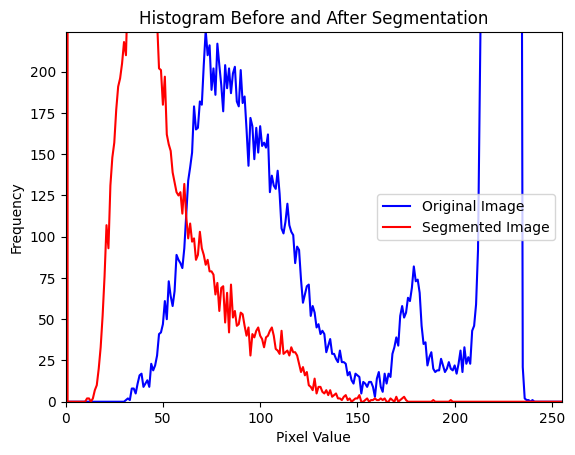

In [11]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

# Loss of Detail: When resizing an image to a smaller size, some details may be lost due to the reduction in pixel density.
#  Similarly, enlarging an image can lead to blurriness or pixelation as the software interpolates to fill in missing information.
# Aspect Ratio Changes: Resizing without maintaining the original aspect ratio can distort the image, making it look stretched or compressed along one dimension.
# EfficientNet models are designed to work well with a wide range of input image sizes. However, the original EfficientNet models were trained on ImageNet with input image sizes of 224x224 for EfficientNetB0 to 600x600 for EfficientNetB7.
#  These sizes represent the typical range of input sizes used during training.
# When you crop an image, you are essentially removing parts of the image that are outside the cropped area. This process reduces the dimensions of the image,
#  resulting in a smaller file size compared to the original image.
for type_name, image_paths in images_dict.items():
    # Load the image
        for image_path in image_paths:
            image = cv2.imread(image_path)
            roi_width = 2200
            roi_height = 2200

            roi_x = (image.shape[1] - roi_width) // 2
            roi_y = (image.shape[0] - roi_height) // 2
            # Crop the image to the ROI
            cropped_image = image[roi_y:roi_y+roi_height, roi_x:roi_x+roi_width]
            cropped_width = cropped_image.shape[1]
            cropped_height = cropped_image.shape[0]

            cropped_aspect_ratio = cropped_width / cropped_height

            cropped_image_rgb = cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB)
            target_width = 224
            target_height = int(target_width / cropped_aspect_ratio)
#  interpolation is the technique for adding or removing pixels during the resizing process. The default is cv2.INTER_LINEAR.(https://cloudinary.com/guides/bulk-image-resize/python-image-resize-with-pillow-and-opencv)
#  inter_area which scales down images , there are other types however inter_area gave the best result
            resized_image = cv2.resize(cropped_image, (target_width, target_height), interpolation=cv2.INTER_AREA)

            hsv_image = cv2.cvtColor(resized_image, cv2.COLOR_BGR2HSV)

            lower_color = np.array([0, 40, 0])
            upper_color = np.array([70, 255, 255])
            # https://realpython.com/python-opencv-color-spaces/
            mask = cv2.inRange(hsv_image, lower_color, upper_color)

            segmented_image = cv2.bitwise_and(resized_image, resized_image, mask=mask)


            kernel = np.ones((7, 7), np.uint8)
            processed_mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=1)

            # Apply the processed mask to the original image
            processed_image = cv2.bitwise_and(resized_image, resized_image, mask=processed_mask)


            original_image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            segmented_image_rgb = cv2.cvtColor(segmented_image, cv2.COLOR_BGR2RGB)
            adjusted_image_rgb = cv2.cvtColor(processed_image, cv2.COLOR_BGR2RGB)
            plt.figure(figsize=(15, 5))

            plt.subplot(1, 4, 1)
            plt.imshow(original_image_rgb)
            plt.title('Original Image')
            plt.axis('off')

            plt.subplot(1, 4, 2)
            plt.imshow(segmented_image_rgb)
            plt.title('Segmented Image')
            plt.axis('off')

            plt.subplot(1, 4, 3)
            plt.imshow(adjusted_image_rgb)
            plt.title('Processed Image')
            plt.axis('off')

            plt.subplot(1, 4, 4)
            plt.imshow(processed_mask)  # Display the mask with a grayscale colormap
            plt.title('Processed Mask')
            plt.axis('off')

            plt.show()

            # plt.subplot(1, 3, 1)
            # plt.imshow(original_image_rgb)
            # plt.title('Original Image')
            # plt.axis('off')
            # plt.subplot(1, 3, 2)
            # plt.imshow(segmented_image_rgb)
            # plt.title('Segmented Image')
            # plt.axis('off')

            # plt.subplot(1, 3, 3)
            # plt.imshow(adjusted_image_rgb)
            # plt.title('processed_image')
            # plt.axis('off')

            # plt.show()
            # original_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
            # segmented_gray = cv2.cvtColor(segmented_image, cv2.COLOR_BGR2GRAY)

            # # Calculate histograms
            # hist_original = cv2.calcHist([original_gray], [0], None, [256], [0, 256])
            # hist_segmented = cv2.calcHist([segmented_gray], [0], None, [256], [0, 256])

            # # Plot histograms
            # plt.plot(hist_original, color='blue')
            # plt.plot(hist_segmented, color='red')
            # plt.title('Histogram Before and After Segmentation')
            # plt.xlabel('Pixel Value')
            # plt.ylabel('Frequency')
            # plt.legend(['Original Image', 'Segmented Image'])
            # plt.show()
            original_gray = cv2.cvtColor(resized_image, cv2.COLOR_BGR2GRAY)
            segmented_gray = cv2.cvtColor(segmented_image, cv2.COLOR_BGR2GRAY)

            hist_original = cv2.calcHist([original_gray], [0], None, [256], [0, 256])
            hist_segmented = cv2.calcHist([processed_image], [0], None, [256], [0, 256])

            plt.plot(hist_original, color='blue')
            plt.plot(hist_segmented, color='red')
            plt.title('Histogram Before and After Segmentation')
            plt.xlabel('Pixel Value')
            plt.ylabel('Frequency')
            plt.legend(['Original Image', 'Segmented Image'])

            # Set the x-axis and y-axis limits
            plt.xlim(0, 255)  # Adjust these limits based on your image data
            plt.ylim(0, 224)  # Adjust these limits based on your image data

            plt.show()

Cropped Image Size: 224x149
Cropped Image Aspect Ratio: 1.00
Resized Image Size: 224x149


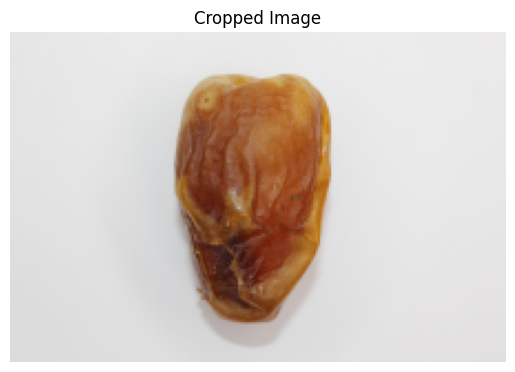

In [ ]:
import cv2
import matplotlib.pyplot as plt

image = cv2.imread('/content/path/to/extract/Sugaey/Sugaey Date (1).JPG')

target_width = 224

aspect_ratio = image.shape[1] / image.shape[0]

# Calculate the target height to maintain the aspect ratio
target_height = int(target_width / aspect_ratio)

# Resize the image
#  interpolation is the technique for adding or removing pixels during the resizing process. The default is cv2.INTER_LINEAR.(https://cloudinary.com/guides/bulk-image-resize/python-image-resize-with-pillow-and-opencv)
#  inter_area which scales down images , there are other types however inter_area gave the best result
resized_image = cv2.resize(image, (target_width, target_height), interpolation=cv2.INTER_AREA)

roi_width = 2000
roi_height = 2000

roi_x = (resized_image.shape[1] - roi_width) // 2
roi_y = (resized_image.shape[0] - roi_height) // 2

cropped_image = resized_image[roi_y:roi_y+roi_height, roi_x:roi_x+roi_width]

print(f"Cropped Image Size: {cropped_image.shape[1]}x{cropped_image.shape[0]}")
print(f"Cropped Image Aspect Ratio: {roi_width / roi_height:.2f}")

print(f"Resized Image Size: {resized_image.shape[1]}x{resized_image.shape[0]}")

cropped_image_rgb = cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB)

plt.imshow(cropped_image_rgb)
plt.title('Cropped Image')
plt.axis('off')
plt.show()


Cropped Image Size: 2000x2000
Cropped Image Aspect Ratio: 1.00
224 224


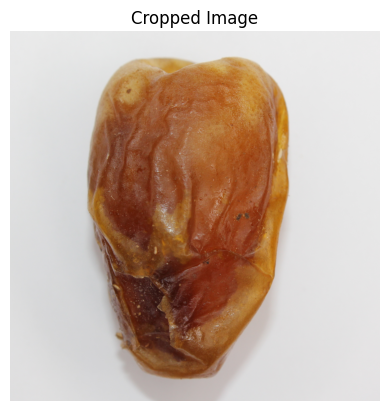

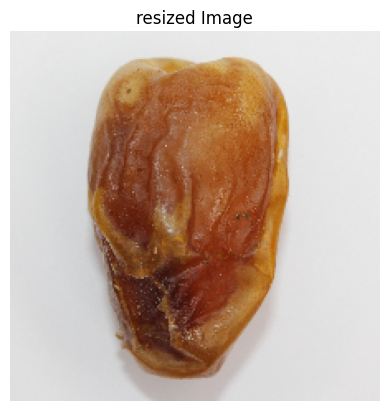

In [ ]:
import cv2
import matplotlib.pyplot as plt

image = cv2.imread('/content/path/to/extract/Sugaey/Sugaey Date (1).JPG')


roi_width = 2000
roi_height = 2000

roi_x = (image.shape[1] - roi_width) // 2  # Centered horizontally
roi_y = (image.shape[0] - roi_height) // 2
cropped_image = image[roi_y:roi_y+roi_height, roi_x:roi_x+roi_width]
cropped_width = cropped_image.shape[1]
cropped_height = cropped_image.shape[0]

cropped_aspect_ratio = cropped_width / cropped_height

print(f"Cropped Image Size: {cropped_width}x{cropped_height}")
print(f"Cropped Image Aspect Ratio: {cropped_aspect_ratio:.2f}")
cropped_image_rgb = cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB)
target_width = 224
target_height = int(target_width / cropped_aspect_ratio)  # Calculate height to maintain aspect ratio

resized_image = cv2.resize(cropped_image, (target_width, target_height), interpolation=cv2.INTER_CUBIC)
print(resized_image.shape[1],resized_image.shape[0])
plt.imshow(cropped_image_rgb)
plt.title('Cropped Image')
plt.axis('off')
plt.show()
plt.imshow(cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB))
plt.title('resized Image')
plt.axis('off')
plt.show()


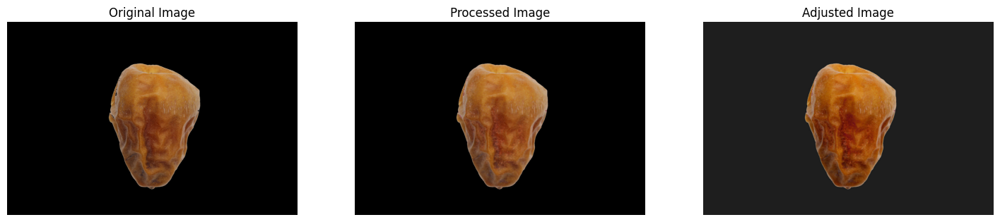

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

original_image = cv2.imread('/content/segmented_images/Sokari/Sokari Date (113).JPG')

hsv_image = cv2.cvtColor(original_image, cv2.COLOR_BGR2HSV)

hue, saturation, value = cv2.split(hsv_image)

kernel = np.ones((3, 3), np.uint8)
processed_value = cv2.morphologyEx(value, cv2.MORPH_CLOSE, kernel, iterations=6)

processed_hsv_image = cv2.merge([hue, saturation, processed_value])

processed_image_bgr = cv2.cvtColor(processed_hsv_image, cv2.COLOR_HSV2BGR)

alpha = 1.2
beta = -30
adjusted_image = cv2.convertScaleAbs(processed_image_bgr, alpha=alpha, beta=beta)

original_image_rgb = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)
processed_image_rgb = cv2.cvtColor(processed_image_bgr, cv2.COLOR_BGR2RGB)
adjusted_image_rgb = cv2.cvtColor(adjusted_image, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(18, 6))

plt.subplot(1, 3, 1)
plt.imshow(original_image_rgb)
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(processed_image_rgb)
plt.title('Processed Image')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(adjusted_image_rgb)
plt.title('Adjusted Image')
plt.axis('off')

plt.show()


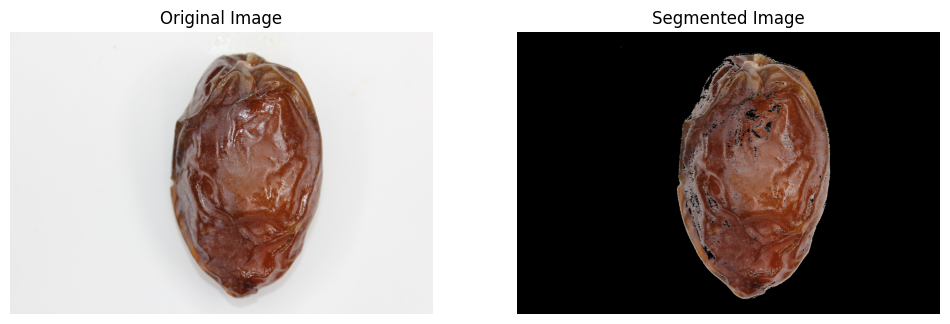

True

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

image = cv2.imread('/content/path/to/extract/Medjool/Medjool Date (1).JPG')

hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

lower_color = np.array([0, 20, 0])
upper_color = np.array([20, 255, 255])

mask = cv2.inRange(hsv_image, lower_color, upper_color)

segmented_image = cv2.bitwise_and(image, image, mask=mask)

segmented_image_rgb = cv2.cvtColor(segmented_image, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(segmented_image_rgb)
plt.title('Segmented Image')
plt.axis('off')
plt.show()
cv2.imwrite('/content/segmented.JPG',segmented_image)


**NOTE: There were additional codes initially present; however, they were removed before recognizing that you want us to include them.**